### 1) Sum $\frac{1}{n^2}$ to a large number and compare with $\frac{\pi^2}{6}$

In [5]:
# import packages
using Plots
using LaTeXStrings

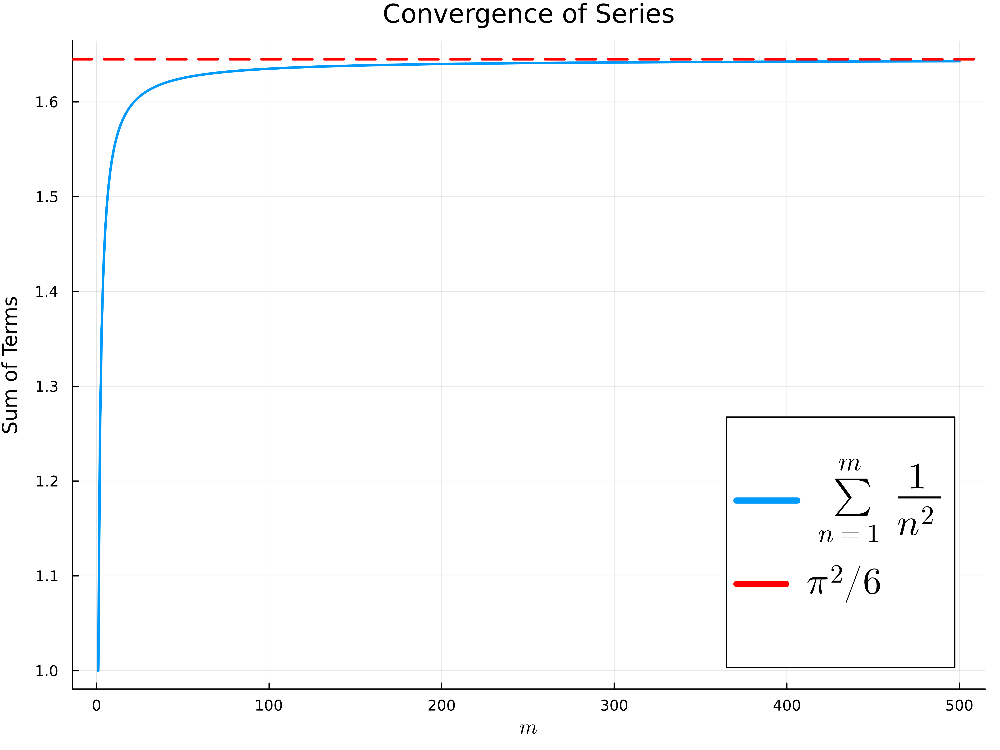

In [12]:
function series(n)
    """
    Calculate the sum of the series 1/n^2 for n terms.
    
    Args:
        n (int): The number of terms in the series.
        
    Returns:
        float: The sum of the series.
    """
    s = 0
    for i in 1:n
        s += 1/i^2
    end
    return s
end

# make a plot for a series for n = 1 to 500
n = 500
s = zeros(n)
for i in 1:n
    s[i] = series(i)
end

Plots.plot(s, label=L"$\sum_{n=1}^{m} \frac{1}{n^2}$", legendfontsize=20, linewidth=2)
Plots.hline!([pi^2/6], label=L"\pi^2/6", color=:red, linestyle=:dash, linewidth=2)
Plots.xlabel!(L"m")
Plots.ylabel!("Sum of Terms")
Plots.title!("Convergence of Series")
Plots.plot!(size=(800, 600), dpi=600)
#savefig("./figs/series.pdf")
#Plots.savefig("./figs/series.png")

### 2) Compute prime numbers - Produce a list of prime numbers upto 1000

In [1]:
function compute_prime(n)
    """
    Compute a list of prime numbers up to a given number.
    
    Args:
        n (int): The upper limit for finding prime numbers.
        
    Returns:
        list: A list of prime numbers up to the given limit.
    """
    primes = []  # initialize an empty list to store prime numbers
    isprime = Dict()  # create a dictionary to store prime number status
    
    # initialize all numbers from 2 to n as prime
    for i in 2:n
        isprime[i] = true
    end
    
    # iterate through numbers from 2 to n
    for i in 2:n
        if isprime[i]  # if the number is prime
            push!(primes, i)  # add it to the list of primes
            
            # mark all multiples of the prime number as non-prime
            for j in i:i:n
                isprime[j] = false
            end
        end
    end
    
    return primes  # return the list of prime numbers
end

compute_prime (generic function with 1 method)

### Bonus task: Ulam´s spiral - represent prime numbers

In [2]:
function sieve_of_eratosthenes(limit)
    """
    Generate prime numbers up to a given limit using the Sieve of Eratosthenes algorithm.
    
    Args:
        limit (int): The upper limit for generating prime numbers.
        
    Returns:
        Array{Bool}: An array indicating whether each number up to the limit is prime or not.
    """
    is_prime = trues(limit + 1)
    is_prime[1] = false
    for i in 2:floor(Int, sqrt(limit))
        if is_prime[i]
            for j in i^2:i:limit
                is_prime[j] = false
            end
        end
    end
    return is_prime
end

sieve_of_eratosthenes (generic function with 1 method)

In [3]:
function spiral_coordinates(n)
    """
    Generate the coordinates of a spiral pattern up to a given number.
    
    Args:
        n (int): The number of coordinates to generate.
        
    Returns:
        Array{Tuple{Int, Int}}: An array of (x, y) coordinates in the spiral pattern.
    """
    x, y = 0, 0
    dx, dy = 1, 0
    steps = 1

    positions = [(x, y)]  # List of coordinates
    for i in 2:n
        x += dx
        y += dy
        push!(positions, (x, y))

        # Change direction based on the spiral logic
        if (dx == 1 && x == steps) || (dx == -1 && x == -steps) || 
           (dy == 1 && y == steps) || (dy == -1 && y == -steps)
            dx, dy = -dy, dx  # Rotate direction
            if dx == 1 || dy == 1
                steps += 1
            end
        end
    end
    return positions
end

spiral_coordinates (generic function with 1 method)

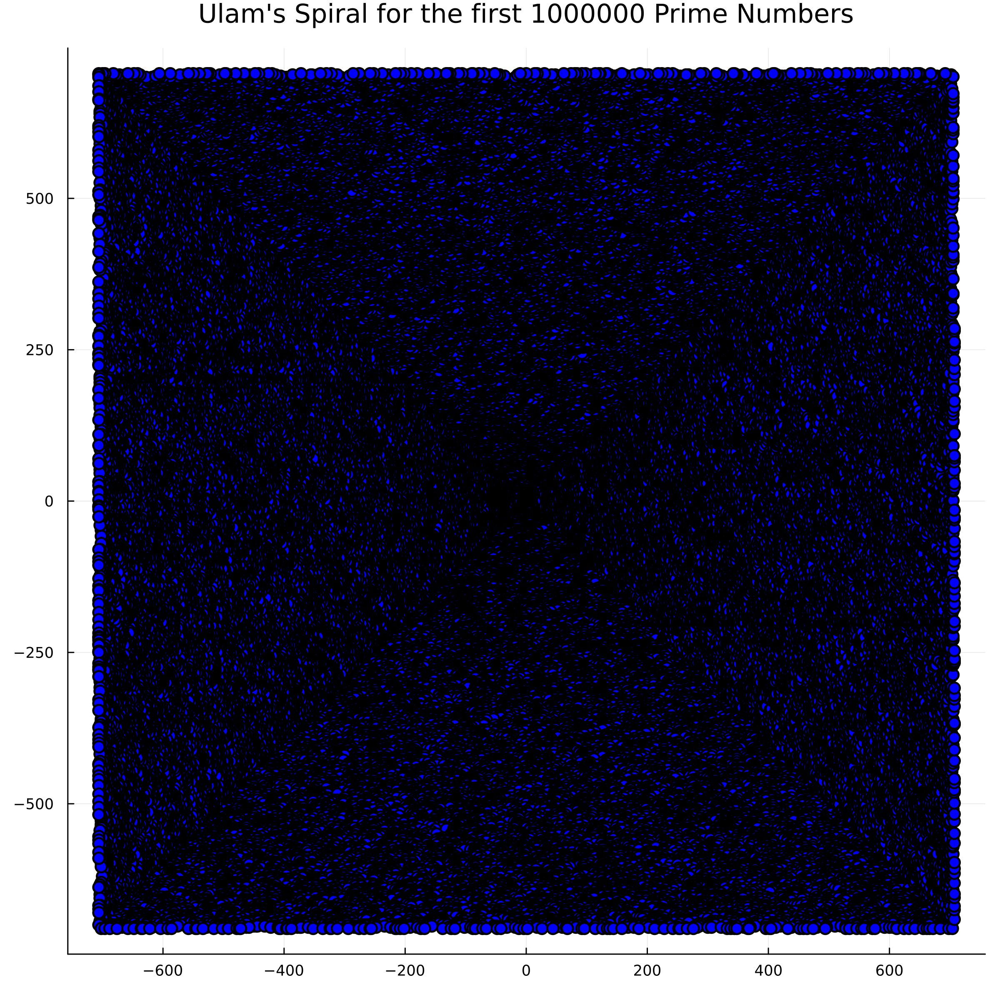

In [8]:
function ulam_spiral(n)
    """
    Generate and plot Ulam's Spiral with prime numbers up to a given number.
    
    Args:
        n (int): The number of primes and coordinates to generate.
        
    Returns:
        Nothing. The function plots the Ulam's Spiral.
    """
    # Generate primes using the sieve
    is_prime = sieve_of_eratosthenes(n)
    
    # Get the spiral coordinates for numbers from 1 to n
    positions = spiral_coordinates(n)

    # Plot the prime numbers on the spiral
    x_coords = []
    y_coords = []
    for i in 1:n
        if is_prime[i]
            x, y = positions[i]
            push!(x_coords, x)
            push!(y_coords, y)
        end
    end

    # Create the plot
    scatter(x_coords, y_coords, markersize=5, markercolor=:blue, 
    title="Ulam's Spiral for the first 1000000 Prime Numbers", legend=false)
    plot!(size=(800, 800), dpi=300, aspect_ratio=:equal)
    #savefig("./figs/ulam_spiral.pdf")
    #savefig("./figs/ulam_spiral.png")
end

# Generate and plot Ulam's Spiral for the first 1000000 numbers
ulam_spiral(1000000)

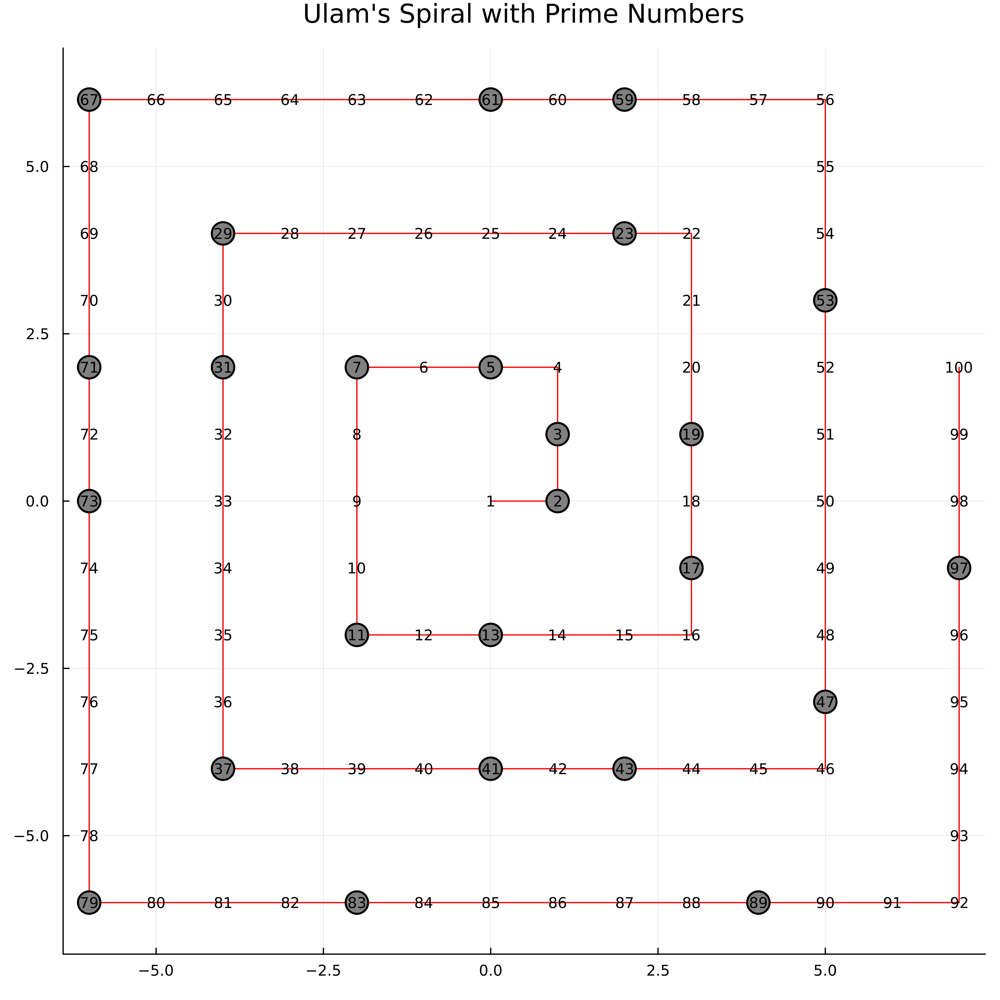

In [7]:
# Modified Ulam's Spiral function
function ulam_spiral_with_lines(n)
    """
    Generate and plot Ulam's Spiral with prime numbers up to a given number with a line.
    
    Args:
        n (int): The number of primes and coordinates to generate.
        
    Returns:
        Nothing. The function plots the Ulam's Spiral.
    """
    # Generate primes using the sieve
    is_prime = sieve_of_eratosthenes(n)
    
    # Get the spiral coordinates for numbers from 1 to n
    positions = spiral_coordinates(n)

    # Plot the numbers on the spiral
    x_coords = []
    y_coords = []
    all_x = []
    all_y = []
    annotations = []
    for i in 1:n
        x, y = positions[i]
        push!(all_x, x)
        push!(all_y, y)
        if is_prime[i]
            push!(x_coords, x)
            push!(y_coords, y)
        end
        # Add number annotation
        push!(annotations, text(string(i), 8, :black))
    end

    # Create the plot
    plot(all_x, all_y, line=:solid, lw=1, color=:red, legend=false, title="Ulam's Spiral with Prime Numbers")
    scatter!(x_coords, y_coords, markersize=10, markercolor=:gray, label="Primes")
    annotate!([(positions[i]..., annotations[i]) for i in 1:n])
    plot!(size=(800, 800), dpi=600, aspect_ratio=:equal)
    #savefig("./figs/ulam_spiral_with_lines.pdf")
    #savefig("./figs/ulam_spiral_with_lines.png")
end

# Generate and plot Ulam's Spiral for the first 100 numbers
ulam_spiral_with_lines(100)